In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import plotly.graph_objs as go
from plotly.offline import plot

In [2]:
df = pd.read_csv("C:/Users/nikhi/Documents/GTD Graph Viz.csv", encoding='ISO-8859-1')
df

,year,country,country_txt,region,region_txt,provstate,city,latitude,longitude,success,attacktype1,attacktype1_txt,targtype1,targtype1_txt,gname,weaptype1,weaptype1_txt
0,2015,95,Iraq,10,Middle East & North Africa,Baghdad,Baghdad,33.303567,44.371771,1,3,Bombing/Explosion,8,Educational Institution,Unknown,6,Explosives
1,2015,198,Sweden,8,Western Europe,Uppsala,Uppsala,59.857979,17.639822,0,7,Facility/Infrastructure Attack,15,Religious Figures/Institutions,Anti-Muslim extremists,8,Incendiary
2,2015,113,Libya,10,Middle East & North Africa,Benghazi,Benghazi,32.069287,20.151145,1,3,Bombing/Explosion,17,Terrorists/Non-State Militia,Shura Council of Benghazi Revolutionaries,6,Explosives
3,2015,95,Iraq,10,Middle East & North Africa,Baghdad,Baghdad,33.303567,44.371771,1,3,Bombing/Explosion,1,Business,Unknown,6,Explosives
4,2015,95,Iraq,10,Middle East & North Africa,Baghdad,Baghdad,33.303567,44.371771,1,3,Bombing/Explosion,14,Private Citizens & Property,Unknown,6,Explosives
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
67377,2020,228,Yemen,10,Middle East & North Africa,Al Hudaydah,Sabaa,15.305307,43.019490,1,3,Bombing/Explosion,14,Private Citizens & Property,Houthi extremists (Ansar Allah),6,Explosives
67378,2020,228,Yemen,10,Middle East & North Africa,Al Hudaydah,Beit Maghari,13.931337,43.478924,1,3,Bombing/Explosion,14,Private Citizens & Property,Houthi extremists (Ansar Allah),6,Explosives
67379,2020,75,Germany,8,Western Europe,Lower Saxony,Leipzig,51.342239,12.374772,1,7,Facility/Infrastructure Attack,4,Military,Left-wing extremists,8,Incendiary
67380,2020,4,Afghanistan,6,South Asia,Kabul,Kabul,34.523842,69.140304,1,2,Armed Assault,14,Private Citizens & Property,Unknown,5,Firearms


In [6]:
G = nx.from_pandas_edgelist(df, 'country_txt', 'gname', edge_attr=True)

degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
closeness_centrality = nx.closeness_centrality(G)
eigenvector_centrality = nx.eigenvector_centrality(G)
clustering_coefficient = nx.clustering(G)

degree_centrality_list = [(k, v) for k, v in degree_centrality.items()]
betweenness_centrality_list = [(k, v) for k, v in betweenness_centrality.items()]
closeness_centrality_list = [(k, v) for k, v in closeness_centrality.items()]
eigenvector_centrality_list = [(k, v) for k, v in eigenvector_centrality.items()]

top_degree_centrality = sorted(degree_centrality_list, key=lambda x: x[1], reverse=True)[:20]
top_betweenness_centrality = sorted(betweenness_centrality_list, key=lambda x: x[1], reverse=True)[:20]
top_closeness_centrality = sorted(closeness_centrality_list, key=lambda x: x[1], reverse=True)[:20]
top_eigenvector_centrality = sorted(eigenvector_centrality_list, key=lambda x: x[1], reverse=True)[:20]

degree_centrality_df = pd.DataFrame(top_degree_centrality, columns=['country_txt', 'degree_centrality'])
betweenness_centrality_df = pd.DataFrame(top_betweenness_centrality, columns=['country_txt', 'betweenness_centrality'])
closeness_centrality_df = pd.DataFrame(top_closeness_centrality, columns=['country_txt', 'closeness_centrality'])
eigenvector_centrality_df = pd.DataFrame(top_eigenvector_centrality, columns=['country_txt', 'eigenvector_centrality'])

print("Top 20 by degree centrality:")
degree_centrality_df

Top 20 by degree centrality:


,country_txt,degree_centrality
0,Unknown,0.140140
1,India,0.130130
2,Syria,0.059059
3,Libya,0.050050
4,Democratic Republic of the Congo,0.049049
5,Pakistan,0.047047
6,Muslim extremists,0.047047
7,United States,0.043043
8,Germany,0.033033
9,Greece,0.033033


In [7]:
print("Top 20 by betweenness centrality:")
betweenness_centrality_df

Top 20 by betweenness centrality:


,country_txt,betweenness_centrality
0,Unknown,0.644313
1,India,0.227353
2,Muslim extremists,0.174394
3,Syria,0.094415
4,Libya,0.088188
5,Democratic Republic of the Congo,0.079615
6,Pakistan,0.076324
7,Greece,0.054960
8,United States,0.054289
9,Nigeria,0.048948


In [8]:
print("Top 20 by closeness centrality:")
closeness_centrality_df

Top 20 by closeness centrality:


,country_txt,closeness_centrality
0,Unknown,0.532593
1,Muslim extremists,0.403190
2,India,0.381863
3,Syria,0.362015
4,Libya,0.359645
5,United States,0.359123
6,Democratic Republic of the Congo,0.359123
7,Pakistan,0.358862
8,Germany,0.356021
9,Greece,0.355253


In [9]:
print("Top 20 by eigenvalue centrality:")
eigenvector_centrality_df

Top 20 by eigenvalue centrality:


,country_txt,eigenvector_centrality
0,Unknown,0.536032
1,Muslim extremists,0.255325
2,India,0.181055
3,Jihadi-inspired extremists,0.143913
4,Islamic State of Iraq and the Levant (ISIL),0.141195
5,Germany,0.136975
6,United States,0.134194
7,France,0.119030
8,United Kingdom,0.118630
9,Russia,0.102033


In [15]:
import plotly.express as px

fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", hover_name="city", color="region_txt",
                        zoom=3, height=500, color_discrete_sequence=px.colors.qualitative.Alphabet)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [19]:
df['attacktype1_txt'].value_counts()

attacktype1_txt
Bombing/Explosion                      29699
Armed Assault                          15322
Unknown                                 6289
Hostage Taking (Kidnapping)             6066
Assassination                           4788
Facility/Infrastructure Attack          4117
Unarmed Assault                          481
Hostage Taking (Barricade Incident)      380
Hijacking                                240
Name: count, dtype: int64

##### The Graph Nodes and the Edges have been replicated everytime when I run the codes again , so they look a lot messy. Please dont mind , I took the screenshot when I ran once and used it for the case study.

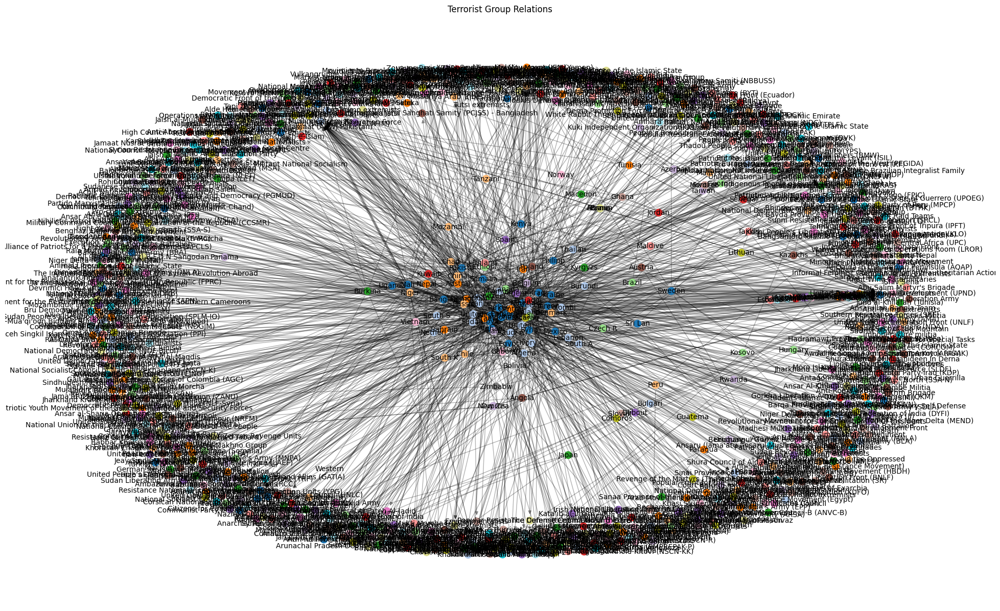

In [23]:
G = nx.from_pandas_edgelist(df, source='country_txt', target='gname', create_using=nx.DiGraph())
node_colors = range(len(G.nodes))

plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G)
node_labels = {}
for node in G.nodes():
    if any(df['country_txt'] == node):
        node_labels[node] = df.loc[df['country_txt'] == node, 'country_txt'].iloc[0][:7]
    else:
        node_labels[node] = node
nx.draw_networkx_nodes(G, pos, node_size=100, node_color=node_colors, cmap=plt.cm.tab20)
nx.draw_networkx_edges(G, pos, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=10, font_color='black')
plt.title("Terrorist Group Relations")
plt.axis('off')
plt.show()


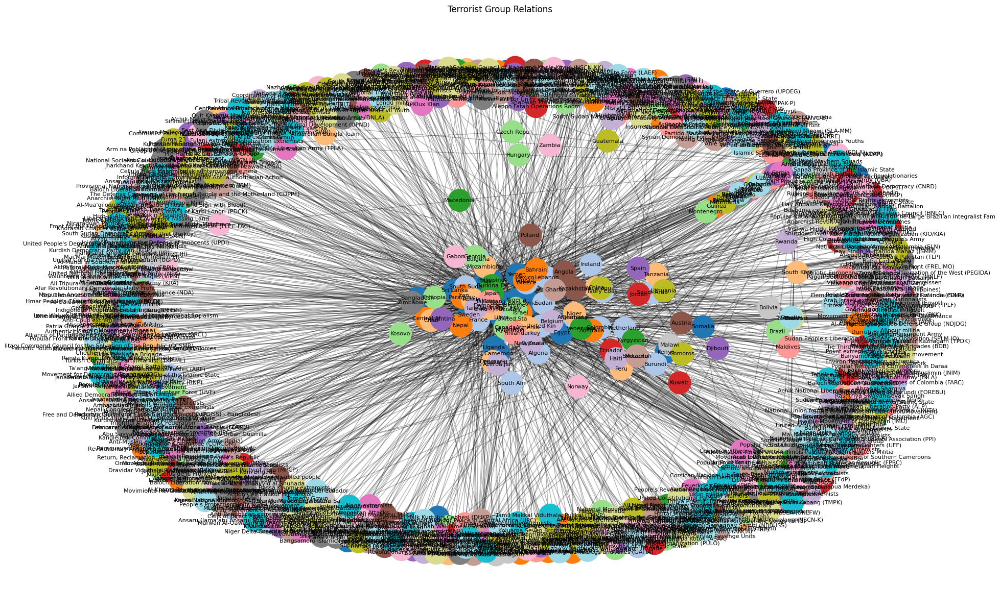

In [26]:
#### Bigger Representation
G = nx.from_pandas_edgelist(df, source='country_txt', target='gname', create_using=nx.DiGraph())
node_colors = range(len(G.nodes))

plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G)
node_labels = {}
for node in G.nodes():
    if any(df['country_txt'] == node):
        node_labels[node] = df.loc[df['country_txt'] == node, 'country_txt'].iloc[0][:10]
    else:
        node_labels[node] = node[:15]
nx.draw_networkx_nodes(G, pos, node_size=1000, node_color=node_colors, cmap=plt.cm.tab20)
nx.draw_networkx_edges(G, pos, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=8, font_color='black')
nx.draw_networkx_labels(G, pos, labels=nx.get_node_attributes(G, 'gname'), font_size=8, font_color='black')
plt.title("Terrorist Group Relations")
plt.axis('off')
plt.show()


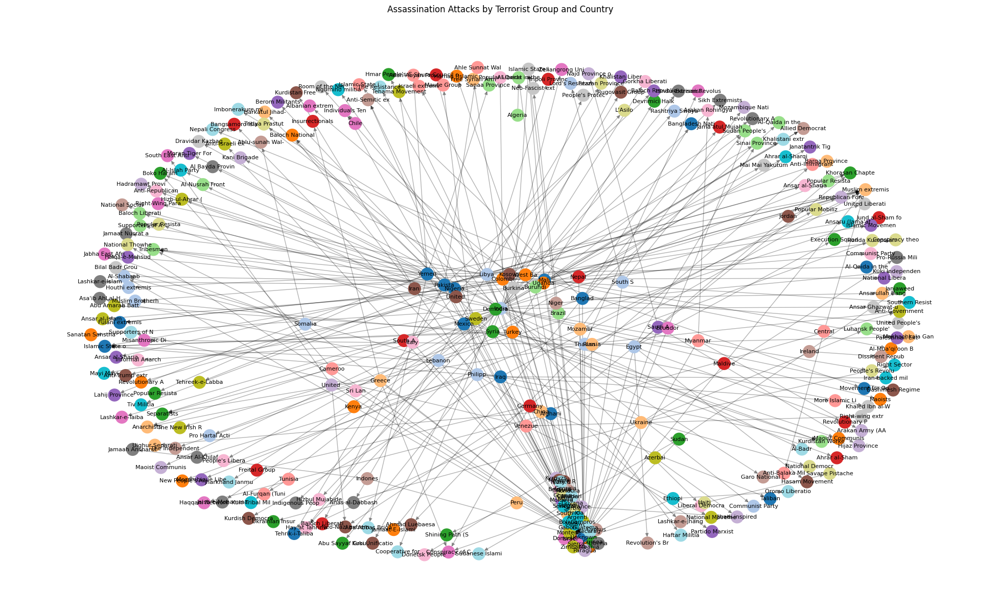

In [30]:
# Filtered the dataframe for assassination attacks
df_assassinations = df[df['attacktype1_txt'] == 'Assassination']
G = nx.from_pandas_edgelist(df_assassinations, source='country_txt', target='gname', create_using=nx.DiGraph())
node_colors = range(len(G.nodes))

# Plot the graph
plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G)
node_labels = {}
for node in G.nodes():
    if any(df['country_txt'] == node):
        node_labels[node] = df.loc[df['country_txt'] == node, 'country_txt'].iloc[0][:7]
    else:
        node_labels[node] = node[:15]
nx.draw_networkx_nodes(G, pos, node_size=300, node_color=node_colors, cmap=plt.cm.tab20)
nx.draw_networkx_edges(G, pos, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=8, font_color='black')
plt.title("Assassination Attacks by Terrorist Group and Country")
plt.axis('off')
plt.show()


In [20]:
df['attacktype1_txt'].unique()

array(['Bombing/Explosion', 'Facility/Infrastructure Attack',
       'Assassination', 'Armed Assault', 'Hostage Taking (Kidnapping)',
       'Unknown', 'Hostage Taking (Barricade Incident)', 'Hijacking',
       'Unarmed Assault'], dtype=object)

Which terrorist group has carried out the most attacks except Unknown?

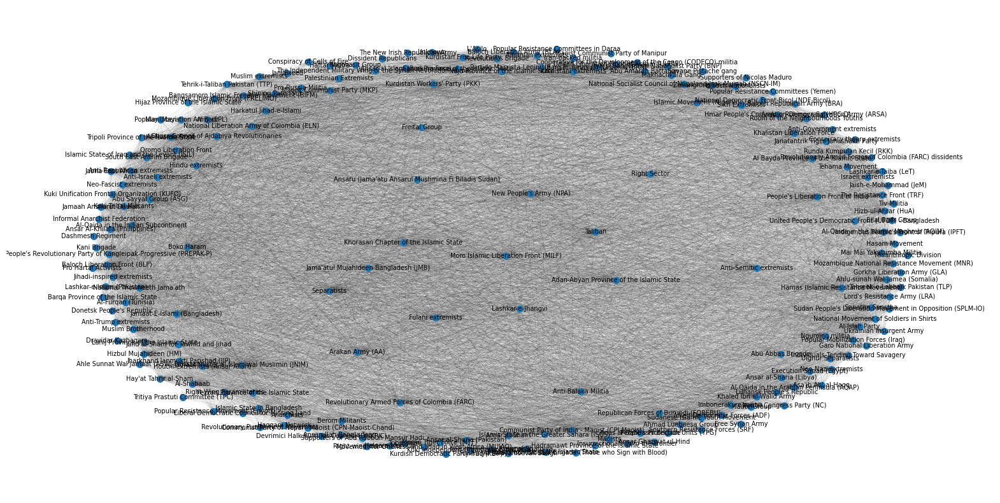

The terrorist group that has carried out the most attacks is: Taliban


In [108]:
attacks_count = df["gname"].value_counts()
G = nx.Graph()
for gname in attacks_count.index:
    G.add_node(gname, weight=attacks_count[gname])

for gname1 in G.nodes():
    for gname2 in G.nodes():
        if gname1 != gname2:
            shared_attacks = len(set(df[df["gname"]==gname1]["targtype1_txt"]).intersection(set(df[df["gname"]==gname2]["targtype1_txt"])))
            if shared_attacks > 0:
                G.add_edge(gname1, gname2, weight=shared_attacks)

pos = nx.spring_layout(G)
plt.figure(figsize=(20,10))
pos = nx.spring_layout(G, seed=42, scale=15, k=5)
nx.draw_networkx_nodes(G, pos, node_size=50)
nx.draw_networkx_edges(G, pos, width=0.03)
nx.draw_networkx_labels(G, pos, font_size=7)
plt.axis("off")
plt.show()

#excluding "Unknown"
attacks_count = df[df["gname"] != "Unknown"]["gname"].value_counts()
most_attacks = attacks_count.index[0]
print("The terrorist group that has carried out the most attacks is:", most_attacks)

Which terrorist groups have attacked the same target types most frequently?

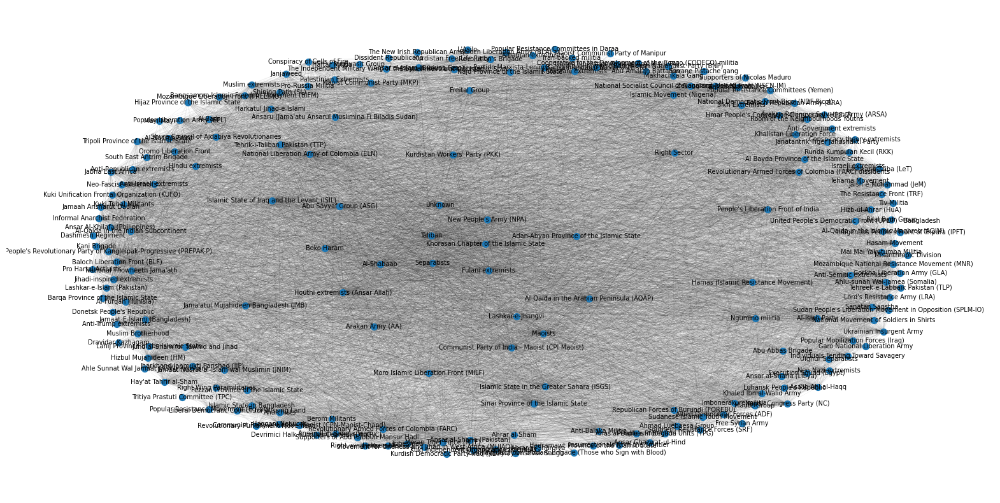

In [109]:
attacks_count = df["gname"].value_counts()
attacks_by_target = df.groupby(["gname", "targtype1_txt"]).size().reset_index(name="count")
G = nx.Graph()

for gname in attacks_count.index:
    G.add_node(gname)

for gname1 in G.nodes():
    for gname2 in G.nodes():
        if gname1 != gname2:
            shared_targets = set(df[df["gname"]==gname1]["targtype1_txt"]).intersection(set(df[df["gname"]==gname2]["targtype1_txt"]))
            if shared_targets:
                weight = sum([attacks_by_target[(attacks_by_target["gname"]==gname1) & (attacks_by_target["targtype1_txt"]==targ)]["count"].iloc[0] for targ in shared_targets])
                G.add_edge(gname1, gname2, weight=weight)

pos = nx.spring_layout(G)
plt.figure(figsize=(20,10))
pos = nx.spring_layout(G, seed=42, scale=15, k=5)
nx.draw_networkx_nodes(G, pos, node_size=50)
nx.draw_networkx_edges(G, pos, width=0.03)
nx.draw_networkx_labels(G, pos, font_size=7)
plt.axis("off")
plt.show()


Get the count of attacks by each terrorist group


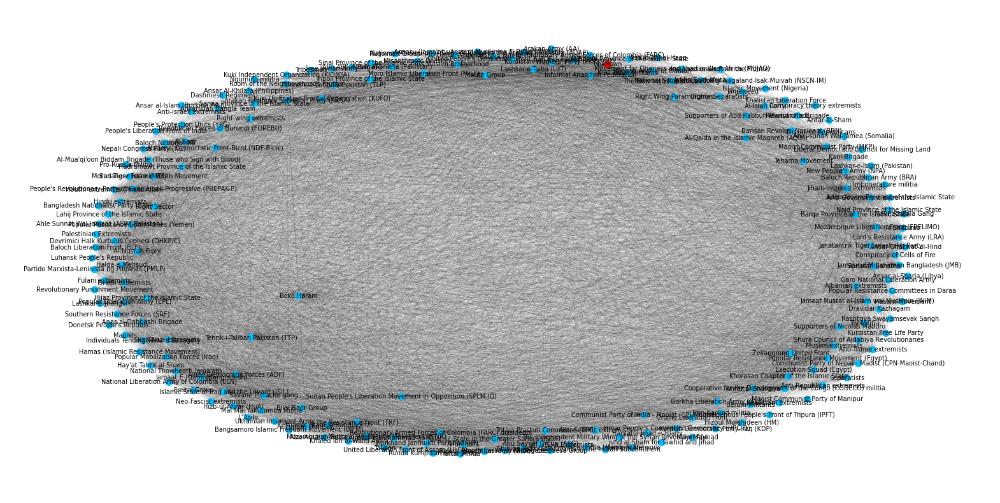

In [168]:
attacks_count = df["gname"].value_counts()

attacks_by_target = df.groupby(["gname", "targtype1_txt"]).size().reset_index(name="count")

G = nx.Graph()
for gname in attacks_count.index:
    G.add_node(gname)

for gname1 in G.nodes():
    for gname2 in G.nodes():
        if gname1 != gname2:
            shared_targets = set(df[df["gname"]==gname1]["targtype1_txt"]).intersection(set(df[df["gname"]==gname2]["targtype1_txt"]))
            if shared_targets:
                weight = sum([attacks_by_target[(attacks_by_target["gname"]==gname1) & (attacks_by_target["targtype1_txt"]==targ)]["count"].iloc[0] for targ in shared_targets])
                G.add_edge(gname1, gname2, weight=weight)

pos = nx.spring_layout(G)
most_attacks = attacks_count.idxmax()
plt.figure(figsize=(20,10))
node_colors = ["red" if node == most_attacks else "deepskyblue" for node in G.nodes()]
pos = nx.spring_layout(G, scale=150, k=10)
nx.draw_networkx_nodes(G, pos, node_size=50, node_color=node_colors)
nx.draw_networkx_edges(G, pos, width=0.03)
nx.draw_networkx_labels(G, pos, font_size=7)
plt.axis("off")
plt.show()

Get the count of attacks by each terrorist group for each target type


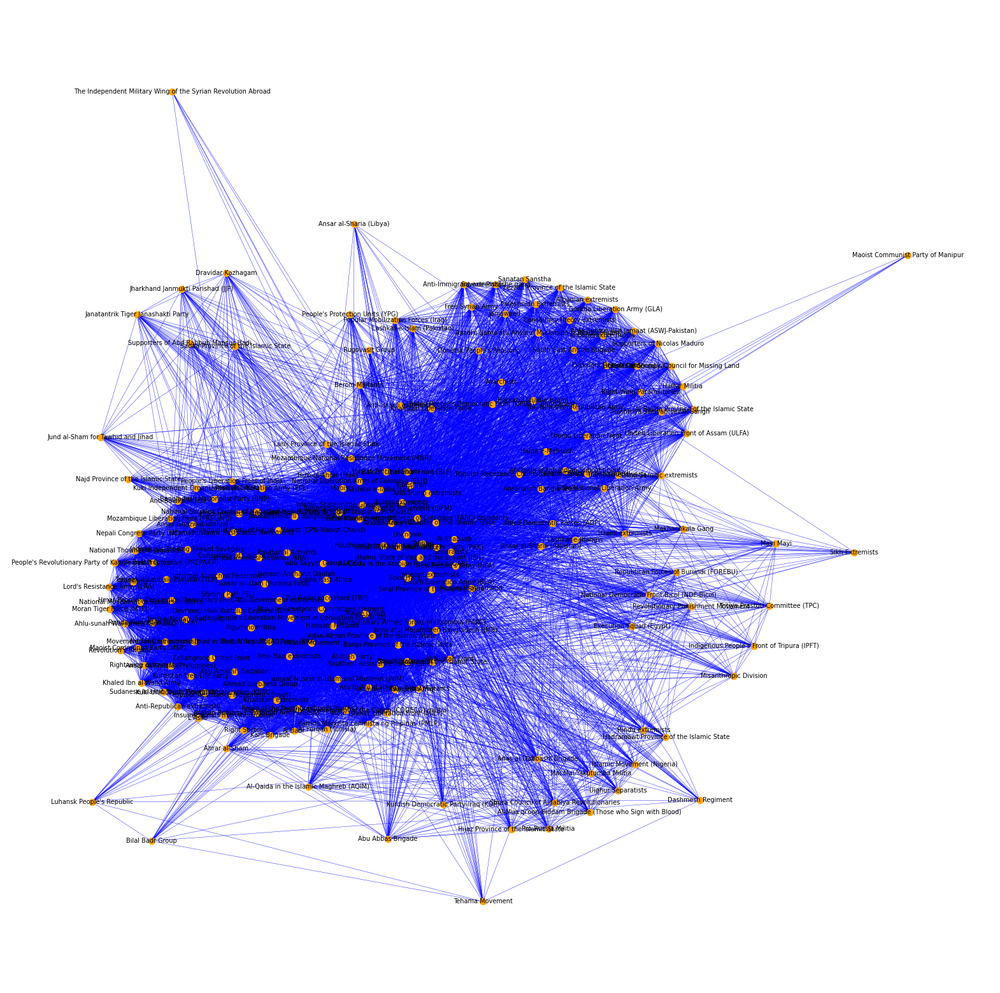

The terrorist group(s) that have attacked the same target types most frequently with a count of 29 are:
Al-Shabaab and Islamic State of Iraq and the Levant (ISIL)
Islamic State of Iraq and the Levant (ISIL) and New People's Army (NPA)


In [122]:
#excluding "Unknown"
attacks_count = df[df["gname"] != "Unknown"]["gname"].value_counts()
group_target_count = df.groupby(["gname", "targtype1_txt"]).size().reset_index(name="count")
G = nx.Graph()
for gname in attacks_count.index:
    G.add_node(gname, weight=attacks_count[gname])

for i in range(len(group_target_count)):
    for j in range(i+1, len(group_target_count)):
        if group_target_count["targtype1_txt"][i] == group_target_count["targtype1_txt"][j]:
            count1 = group_target_count["count"][i]
            count2 = group_target_count["count"][j]
            G.add_edge(group_target_count["gname"][i], group_target_count["gname"][j], weight=min(count1, count2))

plt.figure(figsize=(20,20))
pos = nx.spring_layout(G, scale=150, k=1)
nx.draw_networkx_nodes(G, pos, node_size=50, node_color="orange")
nx.draw_networkx_edges(G, pos, width=0.3, edge_color="blue")
nx.draw_networkx_labels(G, pos, font_size = 7, font_color="black")
plt.axis("off")
plt.show()

most_freq = []
max_weight = 0
for gname1, gname2, weight in G.edges(data="weight"):
    if weight > max_weight:
        max_weight = weight
        most_freq = [(gname1, gname2)]
    elif weight == max_weight:
        most_freq.append((gname1, gname2))
if most_freq:
    print("The terrorist group(s) that have attacked the same target types most frequently with a count of", max_weight, "are:")
    for gname1, gname2 in most_freq:
        print(gname1, "and", gname2)
else:
    print("No terrorist groups have attacked the same target types.")


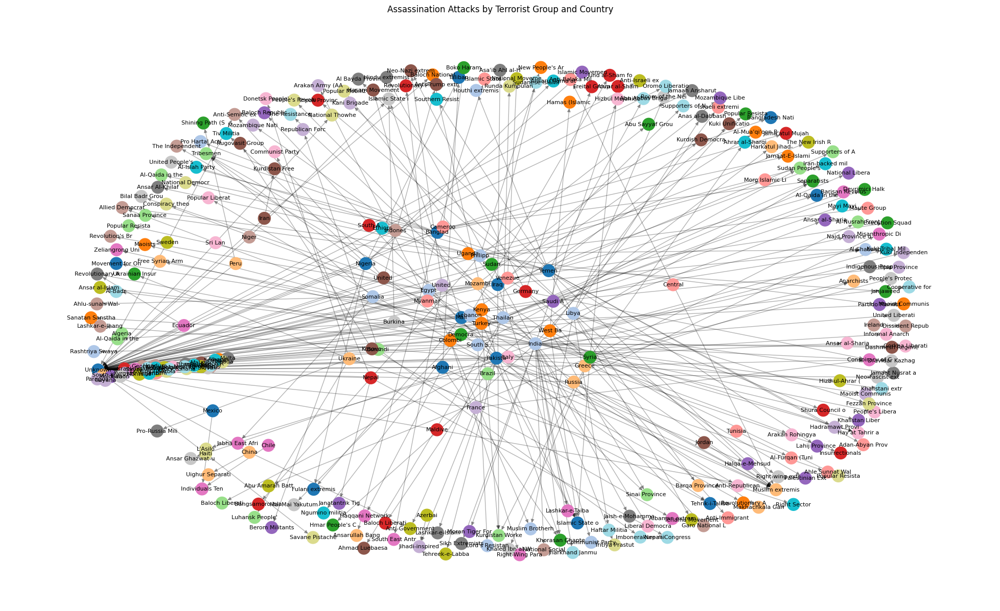

,Degree Centrality,Betweenness Centrality,Closeness Centrality,Eigenvector Centrality
0,Unknown,Iraq,Unknown,Unknown
1,India,Islamic State of Iraq and the Levant (ISIL),Muslim extremists,Muslim extremists
2,Pakistan,Afghanistan,Islamic State of Iraq and the Levant (ISIL),Islamic State of Iraq and the Levant (ISIL)
3,Yemen,Taliban,Tribesmen,Tribesmen
4,Libya,Yemen,Al-Shabaab,Al-Shabaab
5,Syria,Al-Qaida in the Arabian Peninsula (AQAP),Khorasan Chapter of the Islamic State,Khorasan Chapter of the Islamic State
6,Muslim extremists,Bangladesh,Separatists,Separatists
7,Bangladesh,Bangladesh Nationalist Party (BNP),Kurdistan Workers' Party (PKK),Kurdistan Workers' Party (PKK)
8,Philippines,Nigeria,Conspiracy of Cells of Fire,Conspiracy of Cells of Fire
9,Mali,Fulani extremists,Islamic State in the Greater Sahara (ISGS),Islamic State in the Greater Sahara (ISGS)


In [21]:
df_assassinations = df[df['attacktype1_txt'] == 'Assassination']
G = nx.from_pandas_edgelist(df_assassinations, source='country_txt', target='gname', create_using=nx.DiGraph())
node_colors = range(len(G.nodes))

plt.figure(figsize=(25, 15))
pos = nx.spring_layout(G)
node_labels = {}
for node in G.nodes():
    if any(df['country_txt'] == node):
        node_labels[node] = df.loc[df['country_txt'] == node, 'country_txt'].iloc[0][:7]
    else:
        node_labels[node] = node[:15]
nx.draw_networkx_nodes(G, pos, node_size=300, node_color=node_colors, cmap=plt.cm.tab20)
nx.draw_networkx_edges(G, pos, alpha=0.3)
nx.draw_networkx_labels(G, pos, labels=node_labels, font_size=8, font_color='black')
plt.title("Assassination Attacks by Terrorist Group and Country")
plt.axis('off')
plt.show()

degree_centrality = nx.degree_centrality(G)
betweenness_centrality = nx.betweenness_centrality(G)
closeness_centrality = nx.closeness_centrality(G)
eigenvector_centrality = nx.eigenvector_centrality(G, max_iter=1000)
top_nodes = pd.DataFrame({
    'Degree Centrality': dict(sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:10]).keys(),
    'Betweenness Centrality': dict(sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:10]).keys(),
    'Closeness Centrality': dict(sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)[:10]).keys(),
    'Eigenvector Centrality': dict(sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:10]).keys(),
})
top_nodes

In [22]:
country_gname_count = df.groupby(["country_txt", "gname"]).size().reset_index(name="count")
top_countries = df["country_txt"].value_counts().head(10).index
results = []

for country in top_countries:
    top_gnames = country_gname_count[country_gname_count["country_txt"] == country].sort_values(by="count", ascending=False).head(10)
    top_gnames["country_txt"] = country
    results.append(top_gnames)

output_df = pd.concat(results)
output_df

,country_txt,gname,count
590,Iraq,Unknown,6483
567,Iraq,Islamic State of Iraq and the Levant (ISIL),4740
560,Iraq,Asa'ib Ahl al-Haqq,60
573,Iraq,Kurdistan Workers' Party (PKK),42
568,Iraq,Kata'ib Hezbollah,36
...,...,...,...
265,Egypt,Popular Resistance Movement (Egypt),14
262,Egypt,Muslim Brotherhood,12
267,Egypt,Revolutionary Punishment Movement,11
256,Egypt,Ajnad Misr,10


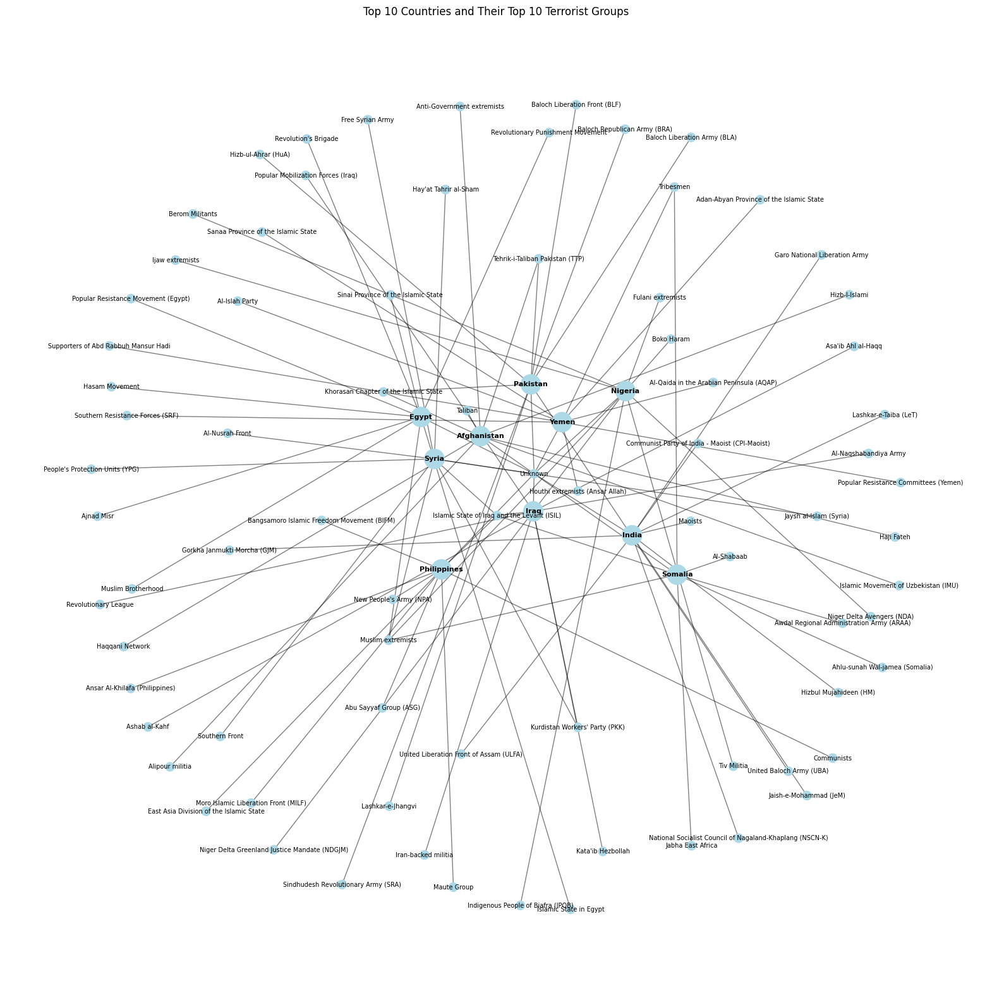

In [3]:
# Get the count of attacks by each country and terrorist group
country_gname_count = df.groupby(["country_txt", "gname"]).size().reset_index(name="count")

# Get the top 10 countries by number of attacks
top_countries = df["country_txt"].value_counts().head(10).index

# Get the top 10 terrorist groups for each of the top 10 countries
top_terrorist_groups = []
for country in top_countries:
    top_groups = country_gname_count[country_gname_count["country_txt"] == country].sort_values(by="count", ascending=False).head(10)
    top_terrorist_groups.extend(list(top_groups["gname"]))

# Create a graph
G = nx.Graph()

# Add nodes for each country and terrorist group
for i, country in enumerate(top_countries):
    G.add_node(country, size=500)
    for j, group in enumerate(top_terrorist_groups):
        G.add_node(group, size=100)

# Add edges for each country and its top 10 terrorist groups
for country in top_countries:
    top_groups = country_gname_count[country_gname_count["country_txt"] == country].sort_values(by="count", ascending=False).head(10)
    for _, row in top_groups.iterrows():
        G.add_edge(country, row["gname"], weight=row["count"])

# Set positions for nodes
plt.figure(figsize=(20,20))
pos = nx.spring_layout(G, k=3, iterations=50)

# Draw nodes and edges
nx.draw_networkx_nodes(G, pos, node_size=[d["size"] for n, d in G.nodes(data=True)], node_color="lightblue")
nx.draw_networkx_edges(G, pos, alpha=0.5)

# Draw node labels
nx.draw_networkx_labels(G, pos, labels={n: n for n in top_countries}, font_size=8, font_weight="bold")
nx.draw_networkx_labels(G, pos, labels={n: n for n in top_terrorist_groups}, font_size=7)

# Set plot options
plt.axis("off")
plt.title("Top 10 Countries and Their Top 10 Terrorist Groups")
plt.show()

In [4]:
import pandas as pd

# Get the count of attacks by each country and attack type
country_attacktype_count = df.groupby(["country_txt", "attacktype1_txt"]).size().reset_index(name="count")

# Get the top 10 countries by number of attacks
top_countries = df["country_txt"].value_counts().head(10).index

# Create an empty DataFrame to store the results
results_df = pd.DataFrame(columns=["Country", "Most Frequent Attack Type", "Count"])

# For each top country, get the most frequent attack type and its count
for country in top_countries:
    country_data = country_attacktype_count[country_attacktype_count["country_txt"] == country]
    max_count = country_data["count"].max()
    max_count_row = country_data[country_data["count"] == max_count].iloc[0]
    results_df = results_df.append({"Country": country, "Most Frequent Attack Type": max_count_row["attacktype1_txt"], "Count": max_count}, ignore_index=True)

# Display the results DataFrame
results_df

C:\Users\nikhi\AppData\Local\Temp\ipykernel_23896\1259876395.py:17: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\nikhi\AppData\Local\Temp\ipykernel_23896\1259876395.py:17: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\nikhi\AppData\Local\Temp\ipykernel_23896\1259876395.py:17: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\nikhi\AppData\Local\Temp\ipykernel_23896\1259876395.py:17: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

C:\Users\nikhi\AppData\Local\Temp\ipykernel_23896\1259876395.py:17: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.co

,Country,Most Frequent Attack Type,Count
0,Iraq,Bombing/Explosion,8547
1,Afghanistan,Bombing/Explosion,3879
2,India,Bombing/Explosion,1971
3,Yemen,Bombing/Explosion,1802
4,Pakistan,Bombing/Explosion,2018
5,Philippines,Armed Assault,1171
6,Nigeria,Armed Assault,1567
7,Somalia,Bombing/Explosion,1185
8,Syria,Bombing/Explosion,1338
9,Egypt,Bombing/Explosion,849


In [5]:
import pandas as pd

# Get the count of attacks by each country and terrorist group
country_gname_count = df.groupby(["country_txt", "gname"]).size().reset_index(name="count")

# Get the top 10 countries by number of attacks
top_countries = df["country_txt"].value_counts().head(10).index

# Create an empty list to store the results
results = []

# Loop through the top countries and append the top terrorist groups to the results list
for country in top_countries:
    top_gnames = country_gname_count[country_gname_count["country_txt"] == country].sort_values(by="count", ascending=False).head(10)
    top_gnames["country_txt"] = country
    results.append(top_gnames)

# Concatenate the results into a single DataFrame
output_df = pd.concat(results)

# Display the DataFrame
output_df

,country_txt,gname,count
590,Iraq,Unknown,6483
567,Iraq,Islamic State of Iraq and the Levant (ISIL),4740
560,Iraq,Asa'ib Ahl al-Haqq,60
573,Iraq,Kurdistan Workers' Party (PKK),42
568,Iraq,Kata'ib Hezbollah,36
...,...,...,...
265,Egypt,Popular Resistance Movement (Egypt),14
262,Egypt,Muslim Brotherhood,12
267,Egypt,Revolutionary Punishment Movement,11
256,Egypt,Ajnad Misr,10
